# 데이터 셋 준비

- 구글 드라이브를 마운트하는 코드이다.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 드라이브 내의 데이터셋 폴더에서 작동시키는 경우

In [ ]:
dataset_dir = "./drive/MyDrive/DCC_dataset" # 드라이브에서 작동

## 드라이브 내의 압축파일에서 코랩 로컬로 압축 해제하여 사용하는 경우

- 데이터셋 파일의 압축을 푸는 코드이다.
  - 압축 파일은 구글 드라이브의 Root에서 *2024 데이터 크리에이터 캠프 대학부 데이터셋.zip* 로 존재해야 함

In [ ]:
!unzip -qq "./drive/MyDrive/2024 데이터 크리에이터 캠프 대학부 데이터셋.zip" -d "./DCC_datasets/"

In [ ]:
dataset_dir = "./DCC_datasets" # 코랩 로컬에서 작동

#Mission 3. 추천 시스템
---

##3-1. 협업필터링(collaborative Filtering)의 2가지를 이해하고 적용해보기

### 3-1-1. 2-2표를 valid에 2기법을 적용


PPT에 작성

### 3-1-2. 장단점 설명

User-based Filtering 적용 방법:
유사한 응답자들의 과거 선호도를 기반으로 새로운 스타일의 선호 여부를 예측한다. 즉 특정 응답자의 스타일 선호도는 그와 유사한 응답자들이 선호한 스타일을 바탕으로 계산한다.


*   응답자의 선호 스타일 정보를 기반으로 유사한 응답자를 찾음.
*   예를 들어, 응답자 A와 선호도를 가진 응답자 B, C가 있다고 가정할 때, A가 아직 평가하지 않은 스타일에 대해 B, C의 평가를 기반으로 A의 선호 여부를 예측



Item-Based Filtering 적용 방법 :
스타일 항목 간의 유사성을 기반으로 응답자의 선호 여부를 예측. 응답자가 이미 선호한 스타일과 유사한 스타일을 추천


*   각 스타일 간의 유사도를 계산하여 응답자가 선호한 스타일과 유사한 다른 스타일을 예측
*   예를 들어, 응답자 A가 '00_cityglam'스타일을 선호했으면, 유사한 '00_oriental' 스타일을 A에게 추천.



## 3-2. Item Based Collaborative Filtering 구현


### 상위 응답자 100명의 데이터 불러오기


*미션 2* 에서 만들었었던 top_100_rows 데이터를 불러오기

In [ ]:
import pandas as pd

# Pickle 파일에서 로드
top_100_rows = pd.read_pickle("/content/drive/MyDrive/top_100_rows.pkl")
print(f"top_100_rows가 성공적으로 로드되었습니다.\n{top_100_rows}")

top_100_rows가 성공적으로 로드되었습니다.
                                            training_비선호  \
응답자ID                                                      
64747  W_47169_70_hippie_W.jpg, W_02498_50_feminine_W...   
64346  W_33015_19_normcore_M.jpg, W_15769_00_metrosex...   
63405  W_17108_19_normcore_M.jpg, W_12443_90_hiphop_M...   
65139  W_26315_19_normcore_M.jpg, W_24629_00_metrosex...   
64561  W_49287_70_punk_W.jpg, W_02232_70_hippie_W.jpg...   
...                                                  ...   
63927  W_17191_19_normcore_M.jpg, W_17040_19_normcore...   
63989  W_15565_70_hippie_M.jpg, W_04324_90_hiphop_M.j...   
50357  W_07324_50_ivy_M.jpg, W_02684_60_mods_M.jpg, W...   
28828  W_15389_60_mods_M.jpg, W_09771_60_mods_M.jpg, ...   
18730  W_12583_70_hippie_M.jpg, W_15795_70_hippie_M.j...   

                                             training_선호  \
응답자ID                                                      
64747  W_21483_19_genderless_W.jpg, W_30434_60_minima...   
64346  W_4

### 피쳐 벡터 추출
모델 로드 및 Featrue Vector 추출함수, 코사인 유사도 함수 정의

In [ ]:
import torch
from torchvision import models, transforms
import torch.nn.functional as F
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

# 모델 불러오기 (weights로 변경)
model = models.resnet18(weights=None)
model_version = "model_epoch_40.pth"  # 모델의 파일명 작성 (model_epoch_{16, 32, 40... etc}.pth)

# 학습된 모델의 가중치 불러오기
model.fc = torch.nn.Linear(model.fc.in_features, 4070)
model.load_state_dict(torch.load(f'/content/drive/MyDrive/model_save/{model_version}', weights_only=True), strict=False)

# 모델을 평가 모드로 전환
model.eval()

# 이미지 전처리 함수 (모델 학습과정과 동일함)
preprocess = transforms.Compose([
      transforms.Resize((224, 224)),
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.54984684, 0.52261154, 0.50516839], std=[0.26895054, 0.26690443, 0.27051458])
])

# Feature Vector를 avgpool에서 추출
def extract_avgpool_feature_vector(model, image):
    # avgpool 레이어의 출력을 가져오기 위해 forward hook 설정
    features = []

    def hook(module, input, output):
        features.append(output.flatten(1))  # 512차원으로 flatten
    handle = model.avgpool.register_forward_hook(hook)

    # 모델에 이미지 입력
    with torch.no_grad():
        model(image)

    handle.remove()  # hook 제거
    return features[0]  # avgpool 특징 벡터 반환

# Feature Vector를 layer4에서 추출
def extract_layer4_feature_vector(model, image):
    # layer4 레이어의 출력을 가져오기 위해 forward hook 설정
    features = []

    def hook(module, input, output):
        features.append(output.flatten(1))  # 512차원으로 flatten
    handle = model.layer4.register_forward_hook(hook)

    # 모델에 이미지 입력
    with torch.no_grad():
        model(image)

    handle.remove()  # hook 제거
    return features[0]  # layer4 특징 벡터 반환


상위 100명의 응답자의 선호, 비선호 리스트에서 각 응답자의 선호/비선호 아이템의 Feature Vector 추출

In [ ]:
import torch
from PIL import Image

# 각 응답자의 선호 및 비선호 feature vector를 저장할 딕셔너리 생성
liked_vectors = {}
disliked_vectors = {}


liked_images = {}
disliked_images = {}

# 상위 100명의 응답자에 대해 반복
total_respondents = len(top_100_rows)  # 전체 응답자 수

for i, (respondent_id, row) in enumerate(top_100_rows.iterrows(), 1):
    # 진행 상황 로그 출력
    print(f"응답자 {i}/{total_respondents} ({respondent_id}) 처리 중...")

    # 응답자의 선호 및 비선호 이미지 파일 리스트
    liked_images[respondent_id] = row.get('training_선호', '').split(', ') if pd.notna(row.get('training_선호')) else []
    disliked_images[respondent_id] = row.get('training_비선호', '').split(', ') if pd.notna(row.get('training_비선호')) else []

    # 선호 이미지를 avgpool feature vector로 변환하여 딕셔너리에 추가
    liked_vectors[respondent_id] = [
        extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(f"{dataset_dir}/training_image/{img_path}").convert('RGB')).unsqueeze(0)
        )
        for img_path in liked_images[respondent_id]
    ]
    print(f"  - 선호 이미지 {len(liked_images[respondent_id])}개 처리 완료.")

    # 비선호 이미지를 avgpool feature vector로 변환하여 딕셔너리에 추가
    disliked_vectors[respondent_id] = [
        extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(f"{dataset_dir}/training_image/{img_path}").convert('RGB')).unsqueeze(0)
        )
        for img_path in disliked_images[respondent_id]
    ]
    print(f"  - 비선호 이미지 {len(disliked_images[respondent_id])}개 처리 완료.")


응답자 1/100 (64747) 처리 중...
  - 선호 이미지 24개 처리 완료.
  - 비선호 이미지 21개 처리 완료.
응답자 2/100 (64346) 처리 중...
  - 선호 이미지 26개 처리 완료.
  - 비선호 이미지 20개 처리 완료.
응답자 3/100 (63405) 처리 중...
  - 선호 이미지 22개 처리 완료.
  - 비선호 이미지 22개 처리 완료.
응답자 4/100 (65139) 처리 중...
  - 선호 이미지 6개 처리 완료.
  - 비선호 이미지 40개 처리 완료.
응답자 5/100 (64561) 처리 중...
  - 선호 이미지 22개 처리 완료.
  - 비선호 이미지 24개 처리 완료.
응답자 6/100 (64633) 처리 중...
  - 선호 이미지 20개 처리 완료.
  - 비선호 이미지 23개 처리 완료.
응답자 7/100 (64223) 처리 중...
  - 선호 이미지 13개 처리 완료.
  - 비선호 이미지 32개 처리 완료.
응답자 8/100 (64310) 처리 중...
  - 선호 이미지 13개 처리 완료.
  - 비선호 이미지 35개 처리 완료.
응답자 9/100 (63369) 처리 중...
  - 선호 이미지 19개 처리 완료.
  - 비선호 이미지 27개 처리 완료.
응답자 10/100 (66513) 처리 중...
  - 선호 이미지 17개 처리 완료.
  - 비선호 이미지 30개 처리 완료.
응답자 11/100 (62952) 처리 중...
  - 선호 이미지 12개 처리 완료.
  - 비선호 이미지 33개 처리 완료.
응답자 12/100 (60173) 처리 중...
  - 선호 이미지 29개 처리 완료.
  - 비선호 이미지 20개 처리 완료.
응답자 13/100 (7905) 처리 중...
  - 선호 이미지 5개 처리 완료.
  - 비선호 이미지 38개 처리 완료.
응답자 14/100 (59704) 처리 중...
  - 선호 이미지 19개 처리 완료.
  - 비선호 이미지 26개 처리 완료.
응답자 

### Legacy
#### 코사인 유사도를 이용한 계산

1.   항목 추가
2.   항목 추가



In [ ]:
import os
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms

# 유사도 계산 함수
def calculate_similarity(vector1, vector2, similarity_function="cosine"):
    # vector1, vector2를 2차원 배열로 변환
    vector1 = vector1.reshape(1, -1) if vector1.ndim == 1 else vector1
    vector2 = vector2.reshape(1, -1) if vector2.ndim == 1 else vector2

    if similarity_function == "cosine":
        return cosine_similarity(vector1, vector2)

# Validation 이미지 경로와 목록 로드
validation_image_dir = dataset_dir + '/validation_image/'
validation_images = os.listdir(validation_image_dir)
print(f"총 {len(validation_images)}개의 Validation 이미지를 처리합니다...")

# 결과 저장용 딕셔너리 초기화
results_dict = {
    "응답자 ID": [],
    "예측한 선호 파일명들": [],
    "예측한 비선호 파일명들": [],
    "검증 선호 파일명들": [],
    "검증 비선호 파일명들": [],
    "예측 성공 개수": [],
    "점수": []
}

# 필수 데이터 확인
try:
    assert liked_images and disliked_images
    assert liked_vectors and disliked_vectors
    print("필요한 데이터가 모두 로드되었습니다.")
except AssertionError:
    raise ValueError("필수 데이터가 초기화되지 않았습니다. `liked_images`, `disliked_images`, `liked_vectors`, `disliked_vectors`를 확인하세요.")

# 예측 결과 저장용 딕셔너리 초기화
predicted_likes = {respondent_id: [] for respondent_id in liked_vectors.keys()}
predicted_dislikes = {respondent_id: [] for respondent_id in liked_vectors.keys()}

# Validation 데이터의 각 이미지에 대해 예측 수행
for i, new_image_filename in enumerate(validation_images, 1):
    new_image_path = f"{validation_image_dir}/{new_image_filename}"
    print(f"[{i}/{len(validation_images)}] '{new_image_filename}' 이미지 처리 중...")

    try:
        # new_image_vector를 2차원 배열로 변환
        new_image_vector = extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(new_image_path).convert('RGB')).unsqueeze(0)
        ).reshape(1, -1)

        for respondent_id in liked_vectors.keys():
            # 유사도 계산
            liked_similarity = calculate_similarity(new_image_vector, np.vstack(liked_vectors[respondent_id]), similarity_function="cosine").mean()
            disliked_similarity = calculate_similarity(new_image_vector, np.vstack(disliked_vectors[respondent_id]), similarity_function="cosine").mean()

            # 임계값 제거 후 비교
            if liked_similarity > disliked_similarity:
                predicted_likes[respondent_id].append((new_image_filename, liked_similarity))
            else:
                predicted_dislikes[respondent_id].append((new_image_filename, disliked_similarity))

    except Exception as e:
        print(f"'{new_image_filename}' 처리 중 오류 발생: {e}")
        continue

# DataFrame 생성 및 결과 저장
print("DataFrame 생성 중...")
for respondent_id in liked_images.keys():
    results_dict["응답자 ID"].append(respondent_id)

    # 유사도 순으로 정렬 후 상위 10개 선택
    top_liked_predictions = [item[0] for item in sorted(predicted_likes[respondent_id], key=lambda x: x[1], reverse=True)[:10]]
    top_disliked_predictions = [item[0] for item in sorted(predicted_dislikes[respondent_id], key=lambda x: x[1], reverse=True)[:10]]

    results_dict["예측한 선호 파일명들"].append(", ".join(top_liked_predictions))
    results_dict["예측한 비선호 파일명들"].append(", ".join(top_disliked_predictions))
    results_dict["검증 선호 파일명들"].append(", ".join(liked_images[respondent_id]))
    results_dict["검증 비선호 파일명들"].append(", ".join(disliked_images[respondent_id]))

    success_count = len(set(top_liked_predictions) & set(liked_images[respondent_id]))
    score = min(success_count * 5, 100)

    results_dict["예측 성공 개수"].append(success_count)
    results_dict["점수"].append(score)

df_results = pd.DataFrame(results_dict)
print("DataFrame 생성 완료!")
print(df_results)

총 951개의 Validation 이미지를 처리합니다...
필요한 데이터가 모두 로드되었습니다.
[1/951] 'W_11726_50_feminine_W.jpg' 이미지 처리 중...
[2/951] 'W_01933_50_feminine_W.jpg' 이미지 처리 중...
[3/951] 'W_37491_70_military_W.jpg' 이미지 처리 중...
[4/951] 'W_14783_60_minimal_W.jpg' 이미지 처리 중...
[5/951] 'W_24590_60_mods_M.jpg' 이미지 처리 중...
[6/951] 'W_06860_19_normcore_M.jpg' 이미지 처리 중...
[7/951] 'W_24685_80_bold_M.jpg' 이미지 처리 중...
[8/951] 'W_03144_50_classic_W.jpg' 이미지 처리 중...
[9/951] 'W_15699_70_hippie_M.jpg' 이미지 처리 중...
[10/951] 'W_10186_80_powersuit_W.jpg' 이미지 처리 중...
[11/951] 'W_12298_70_hippie_M.jpg' 이미지 처리 중...
[12/951] 'W_00073_50_ivy_M.jpg' 이미지 처리 중...
[13/951] 'W_09307_60_popart_W.jpg' 이미지 처리 중...
[14/951] 'W_11659_50_feminine_W.jpg' 이미지 처리 중...
[15/951] 'W_17004_10_sportivecasual_M.jpg' 이미지 처리 중...
[16/951] 'W_19576_90_grunge_W.jpg' 이미지 처리 중...
[17/951] 'W_02498_50_feminine_W.jpg' 이미지 처리 중...
[18/951] 'W_10107_60_mods_M.jpg' 이미지 처리 중...
[19/951] 'W_16374_10_sportivecasual_M.jpg' 이미지 처리 중...
[20/951] 'W_24141_50_ivy_M.jpg' 이미지 처리

#### 4개의 유사도 측정 함수를 비교하는 코드
> 유사도 방식별 평균 예측 성공 개수: {'Cosine': 0.03, 'MSD': 0.03, 'Pearson': 0.41, 'Jaccard': 0.14}

결과: 피어슨이 제일 우수하였음

In [ ]:
import os
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity, pairwise_distances
from scipy.stats import pearsonr
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms

# 유사도 계산 함수들
def cosine_sim(vector1, vector2):
    return cosine_similarity(vector1, vector2).mean()

def msd_sim(vector1, vector2):
    return -np.square(vector1 - vector2).mean()

def pearson_sim(vector1, vector2):
    sim = [pearsonr(vector1[0], v)[0] for v in vector2]
    return np.mean(sim)

def jaccard_sim(vector1, vector2):
    return 1 - pairwise_distances(vector1, vector2, metric="jaccard").mean()

# 각 유사도 방식으로 예측
similarity_functions = {
    "Cosine": cosine_sim,
    "MSD": msd_sim,
    "Pearson": pearson_sim,
    "Jaccard": jaccard_sim
}

# Validation 이미지 경로와 목록 로드
validation_image_dir = dataset_dir + '/validation_image/'
validation_images = os.listdir(validation_image_dir)
print(f"총 {len(validation_images)}개의 Validation 이미지를 처리합니다...")

# 결과 저장용 딕셔너리 초기화
results_dicts = {sim: {"응답자 ID": [], "예측 성공 개수": [], "점수": []} for sim in similarity_functions.keys()}

# 필수 데이터 확인
try:
    assert liked_images and disliked_images
    assert liked_vectors and disliked_vectors
    print("필요한 데이터가 모두 로드되었습니다.")
except AssertionError:
    raise ValueError("필수 데이터가 초기화되지 않았습니다. `liked_images`, `disliked_images`, `liked_vectors`, `disliked_vectors`를 확인하세요.")

# 각 유사도 방식별 예측 수행
for sim_name, sim_func in similarity_functions.items():
    predicted_likes = {respondent_id: [] for respondent_id in liked_vectors.keys()}
    predicted_dislikes = {respondent_id: [] for respondent_id in liked_vectors.keys()}

    for i, new_image_filename in enumerate(validation_images, 1):
        new_image_path = f"{validation_image_dir}/{new_image_filename}"
        print(f"[{i}/{len(validation_images)}] '{new_image_filename}' 이미지 처리 중...")

        try:
            new_image_vector = extract_avgpool_feature_vector(
                model,
                preprocess(Image.open(new_image_path).convert('RGB')).unsqueeze(0)
            ).reshape(1, -1)

            for respondent_id in liked_vectors.keys():
                liked_similarity = sim_func(new_image_vector, np.vstack(liked_vectors[respondent_id]))
                disliked_similarity = sim_func(new_image_vector, np.vstack(disliked_vectors[respondent_id]))

                # 임계값 제거 후 비교
                if liked_similarity > disliked_similarity:
                    predicted_likes[respondent_id].append((new_image_filename, liked_similarity))
                else:
                    predicted_dislikes[respondent_id].append((new_image_filename, disliked_similarity))

        except Exception as e:
            print(f"'{new_image_filename}' 처리 중 오류 발생: {e}")
            continue

    # DataFrame 생성 및 결과 저장
    for respondent_id in liked_images.keys():
        results_dicts[sim_name]["응답자 ID"].append(respondent_id)

        top_liked_predictions = [item[0] for item in sorted(predicted_likes[respondent_id], key=lambda x: x[1], reverse=True)[:20]]
        top_disliked_predictions = [item[0] for item in sorted(predicted_dislikes[respondent_id], key=lambda x: x[1], reverse=True)[:20]]

        success_count = len(set(top_liked_predictions) & set(liked_images[respondent_id]))
        score = min(success_count * 5, 100)

        results_dicts[sim_name]["예측 성공 개수"].append(success_count)
        results_dicts[sim_name]["점수"].append(score)

# 유사도 방식별 평균 예측 성공 개수 계산
mean_success_counts = {sim_name: np.mean(results_dicts[sim_name]["예측 성공 개수"]) for sim_name in similarity_functions.keys()}
print("유사도 방식별 평균 예측 성공 개수:", mean_success_counts)


총 951개의 Validation 이미지를 처리합니다...
필요한 데이터가 모두 로드되었습니다.
[1/951] 'W_11726_50_feminine_W.jpg' 이미지 처리 중...
[2/951] 'W_01933_50_feminine_W.jpg' 이미지 처리 중...
[3/951] 'W_37491_70_military_W.jpg' 이미지 처리 중...
[4/951] 'W_14783_60_minimal_W.jpg' 이미지 처리 중...
[5/951] 'W_24590_60_mods_M.jpg' 이미지 처리 중...
[6/951] 'W_06860_19_normcore_M.jpg' 이미지 처리 중...
[7/951] 'W_24685_80_bold_M.jpg' 이미지 처리 중...
[8/951] 'W_03144_50_classic_W.jpg' 이미지 처리 중...
[9/951] 'W_15699_70_hippie_M.jpg' 이미지 처리 중...
[10/951] 'W_10186_80_powersuit_W.jpg' 이미지 처리 중...
[11/951] 'W_12298_70_hippie_M.jpg' 이미지 처리 중...
[12/951] 'W_00073_50_ivy_M.jpg' 이미지 처리 중...
[13/951] 'W_09307_60_popart_W.jpg' 이미지 처리 중...
[14/951] 'W_11659_50_feminine_W.jpg' 이미지 처리 중...
[15/951] 'W_17004_10_sportivecasual_M.jpg' 이미지 처리 중...
[16/951] 'W_19576_90_grunge_W.jpg' 이미지 처리 중...
[17/951] 'W_02498_50_feminine_W.jpg' 이미지 처리 중...
[18/951] 'W_10107_60_mods_M.jpg' 이미지 처리 중...
[19/951] 'W_16374_10_sportivecasual_M.jpg' 이미지 처리 중...
[20/951] 'W_24141_50_ivy_M.jpg' 이미지 처리

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[2/951] 'W_01933_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[3/951] 'W_37491_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[4/951] 'W_14783_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[5/951] 'W_24590_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[6/951] 'W_06860_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[7/951] 'W_24685_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[8/951] 'W_03144_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[9/951] 'W_15699_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[10/951] 'W_10186_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[11/951] 'W_12298_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[12/951] 'W_00073_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[13/951] 'W_09307_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[14/951] 'W_11659_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[15/951] 'W_17004_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[16/951] 'W_19576_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[17/951] 'W_02498_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[18/951] 'W_10107_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[19/951] 'W_16374_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[20/951] 'W_24141_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[21/951] 'W_16452_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[22/951] 'W_17347_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[23/951] 'W_13973_90_lingerie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[24/951] 'W_06788_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[25/951] 'W_13991_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[26/951] 'W_17304_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[27/951] 'W_40642_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[28/951] 'W_07333_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[29/951] 'W_10455_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[30/951] 'W_52693_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[31/951] 'W_45137_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[32/951] 'W_06609_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[33/951] 'W_13535_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[34/951] 'W_12773_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[35/951] 'W_16732_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[36/951] 'W_19967_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[37/951] 'W_34808_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[38/951] 'W_00492_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[39/951] 'W_44330_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[40/951] 'W_05941_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[41/951] 'W_44520_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[42/951] 'W_12393_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[43/951] 'W_02306_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[44/951] 'W_13688_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[45/951] 'W_04101_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[46/951] 'W_05526_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[47/951] 'W_41341_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[48/951] 'W_08733_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[49/951] 'W_19833_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[50/951] 'W_00624_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[51/951] 'W_06531_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[52/951] 'W_28203_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[53/951] 'W_15729_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[54/951] 'W_29990_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[55/951] 'W_39812_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[56/951] 'W_24556_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[57/951] 'W_24203_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[58/951] 'W_33259_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[59/951] 'W_19158_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[60/951] 'W_22623_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[61/951] 'W_18670_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[62/951] 'W_16541_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[63/951] 'W_12476_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[64/951] 'W_08837_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[65/951] 'W_14785_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[66/951] 'W_05321_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[67/951] 'W_06533_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[68/951] 'W_08715_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[69/951] 'W_29347_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[70/951] 'W_12247_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[71/951] 'W_16516_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[72/951] 'W_47862_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[73/951] 'W_09085_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[74/951] 'W_03587_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[75/951] 'W_17841_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[76/951] 'W_01056_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[77/951] 'W_12128_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[78/951] 'W_29258_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[79/951] 'W_06867_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[80/951] 'W_08467_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[81/951] 'W_11214_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[82/951] 'W_18080_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[83/951] 'W_19454_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[84/951] 'W_27899_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[85/951] 'W_48687_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[86/951] 'W_54129_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[87/951] 'W_15662_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[88/951] 'W_27184_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[89/951] 'W_05736_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[90/951] 'W_07316_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[91/951] 'W_11163_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[92/951] 'W_11936_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[93/951] 'W_06525_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[94/951] 'W_00598_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[95/951] 'W_04245_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[96/951] 'W_14469_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[97/951] 'W_14888_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[98/951] 'W_24211_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[99/951] 'W_15402_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[100/951] 'W_12702_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[101/951] 'W_24643_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[102/951] 'W_17747_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[103/951] 'W_47546_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[104/951] 'W_05917_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[105/951] 'W_17202_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[106/951] 'W_02660_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[107/951] 'W_00829_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[108/951] 'W_15217_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[109/951] 'W_30671_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[110/951] 'W_17854_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[111/951] 'W_02557_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[112/951] 'W_13656_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[113/951] 'W_09881_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[114/951] 'W_11685_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[115/951] 'W_06186_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[116/951] 'W_06547_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[117/951] 'W_39793_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[118/951] 'W_06917_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[119/951] 'T_00253_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[120/951] 'W_19820_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[121/951] 'W_05271_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[122/951] 'W_07271_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[123/951] 'W_17603_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[124/951] 'W_05580_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[125/951] 'W_04629_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[126/951] 'W_10167_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[127/951] 'W_11495_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[128/951] 'W_25406_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[129/951] 'W_16295_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[130/951] 'W_08040_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[131/951] 'W_13957_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[132/951] 'W_14787_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[133/951] 'W_18094_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[134/951] 'W_47967_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[135/951] 'W_22239_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[136/951] 'W_12462_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[137/951] 'W_07025_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[138/951] 'W_15716_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[139/951] 'W_08951_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[140/951] 'W_14852_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[141/951] 'W_02275_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[142/951] 'W_32445_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[143/951] 'W_14039_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[144/951] 'W_29023_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[145/951] 'W_06000_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[146/951] 'W_34093_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[147/951] 'W_49765_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[148/951] 'W_03624_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[149/951] 'W_17697_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[150/951] 'W_08115_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[151/951] 'W_10191_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[152/951] 'W_24152_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[153/951] 'W_08641_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[154/951] 'W_10686_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[155/951] 'W_25934_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[156/951] 'W_13254_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[157/951] 'W_24931_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[158/951] 'W_06895_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[159/951] 'W_18249_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[160/951] 'W_34027_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[161/951] 'W_17785_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[162/951] 'W_25909_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[163/951] 'W_11024_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[164/951] 'W_27850_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[165/951] 'W_00366_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[166/951] 'W_12518_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[167/951] 'W_16747_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[168/951] 'W_03536_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[169/951] 'W_00540_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[170/951] 'W_02701_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[171/951] 'W_06590_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[172/951] 'W_29942_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[173/951] 'W_10429_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[174/951] 'W_05562_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[175/951] 'W_24883_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[176/951] 'W_17353_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[177/951] 'T_07990_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[178/951] 'W_12410_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[179/951] 'W_29897_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[180/951] 'W_28453_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[181/951] 'W_08246_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[182/951] 'W_09182_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[183/951] 'W_22510_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[184/951] 'W_33240_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[185/951] 'W_17333_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[186/951] 'W_23410_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[187/951] 'W_05667_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[188/951] 'W_17062_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[189/951] 'W_11509_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[190/951] 'W_09119_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[191/951] 'W_06448_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[192/951] 'W_01410_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[193/951] 'W_18213_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[194/951] 'W_09001_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[195/951] 'W_05818_90_lingerie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[196/951] 'W_00496_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[197/951] 'W_12002_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[198/951] 'W_16848_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[199/951] 'W_04845_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[200/951] 'W_03623_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[201/951] 'W_01853_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[202/951] 'W_25194_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[203/951] 'W_03531_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[204/951] 'W_15756_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[205/951] 'W_10779_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[206/951] 'W_06955_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[207/951] 'W_43283_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[208/951] 'W_17221_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[209/951] 'W_25981_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[210/951] 'W_10844_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[211/951] 'W_25202_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[212/951] 'W_09763_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[213/951] 'W_06148_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[214/951] 'W_17623_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[215/951] 'W_00161_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[216/951] 'W_04840_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[217/951] 'W_25235_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[218/951] 'W_52140_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[219/951] 'W_00931_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[220/951] 'W_11610_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[221/951] 'W_10103_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[222/951] 'W_04994_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[223/951] 'W_00804_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[224/951] 'W_19559_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[225/951] 'W_24628_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[226/951] 'W_00974_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[227/951] 'W_14828_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[228/951] 'W_10558_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[229/951] 'W_29658_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[230/951] 'W_13518_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[231/951] 'W_02243_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[232/951] 'W_07187_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[233/951] 'W_02962_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[234/951] 'W_15140_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[235/951] 'W_15661_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[236/951] 'W_15910_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[237/951] 'W_13354_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[238/951] 'W_01179_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[239/951] 'W_32385_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[240/951] 'W_17787_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[241/951] 'W_19545_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[242/951] 'W_00551_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[243/951] 'W_03003_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[244/951] 'W_08621_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[245/951] 'T_21986_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[246/951] 'W_08839_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[247/951] 'W_09752_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[248/951] 'W_15856_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[249/951] 'W_14272_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[250/951] 'W_23848_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[251/951] 'W_16362_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[252/951] 'W_33901_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[253/951] 'W_08977_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[254/951] 'W_57473_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[255/951] 'W_11912_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[256/951] 'W_15791_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[257/951] 'W_07643_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[258/951] 'W_14357_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[259/951] 'W_15758_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[260/951] 'W_12904_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[261/951] 'W_03522_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[262/951] 'W_19520_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[263/951] 'W_04684_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[264/951] 'W_02140_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[265/951] 'W_50836_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[266/951] 'W_07916_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[267/951] 'W_11266_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[268/951] 'W_18992_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[269/951] 'W_18057_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[270/951] 'W_19945_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[271/951] 'W_06011_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[272/951] 'W_09750_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[273/951] 'W_09698_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[274/951] 'W_25790_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[275/951] 'W_00709_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[276/951] 'W_05760_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[277/951] 'W_60184_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[278/951] 'W_17414_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[279/951] 'W_64332_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[280/951] 'W_18482_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[281/951] 'W_02277_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[282/951] 'W_28909_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[283/951] 'W_15381_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[284/951] 'W_17366_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[285/951] 'W_07226_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[286/951] 'W_38585_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[287/951] 'W_34504_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[288/951] 'W_29918_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[289/951] 'W_17532_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[290/951] 'W_11903_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[291/951] 'W_16247_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[292/951] 'W_05787_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[293/951] 'W_24838_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[294/951] 'W_03026_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[295/951] 'W_62253_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[296/951] 'W_23971_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[297/951] 'W_17058_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[298/951] 'W_44918_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[299/951] 'W_03927_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[300/951] 'W_63644_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[301/951] 'W_05181_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[302/951] 'W_27765_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[303/951] 'W_24250_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[304/951] 'W_08402_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[305/951] 'W_18737_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[306/951] 'W_09747_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[307/951] 'W_14914_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[308/951] 'W_16505_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[309/951] 'W_12668_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[310/951] 'W_14417_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[311/951] 'W_62313_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[312/951] 'W_19205_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[313/951] 'W_47408_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[314/951] 'W_09731_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[315/951] 'W_06786_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[316/951] 'W_26324_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[317/951] 'W_04622_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[318/951] 'W_15270_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[319/951] 'W_13277_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[320/951] 'W_16460_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[321/951] 'W_19207_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[322/951] 'W_17305_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[323/951] 'W_10079_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[324/951] 'W_12567_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[325/951] 'W_18506_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[326/951] 'W_24647_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[327/951] 'W_07490_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[328/951] 'W_06797_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[329/951] 'W_31823_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[330/951] 'W_09285_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[331/951] 'W_07018_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[332/951] 'W_06090_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[333/951] 'W_08285_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[334/951] 'W_15947_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[335/951] 'W_34080_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[336/951] 'W_31913_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[337/951] 'W_02691_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[338/951] 'W_24598_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[339/951] 'W_37014_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[340/951] 'W_24573_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[341/951] 'W_17867_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[342/951] 'W_03258_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[343/951] 'W_32314_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[344/951] 'W_00625_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[345/951] 'W_16485_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[346/951] 'W_07877_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[347/951] 'W_16503_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[348/951] 'W_58887_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[349/951] 'W_07811_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[350/951] 'W_09277_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[351/951] 'W_35091_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[352/951] 'W_30988_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[353/951] 'W_01234_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[354/951] 'W_06557_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[355/951] 'W_01105_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[356/951] 'W_04212_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[357/951] 'W_46907_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[358/951] 'W_03685_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[359/951] 'T_21992_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[360/951] 'W_07753_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[361/951] 'W_14691_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[362/951] 'W_12817_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[363/951] 'W_34623_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[364/951] 'W_27773_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[365/951] 'W_58793_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[366/951] 'W_13186_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[367/951] 'W_17032_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[368/951] 'W_51577_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[369/951] 'W_30431_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[370/951] 'W_19075_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[371/951] 'W_08262_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[372/951] 'W_39164_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[373/951] 'W_17783_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[374/951] 'W_15843_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[375/951] 'W_15740_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[376/951] 'W_15141_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[377/951] 'W_08139_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[378/951] 'W_13574_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[379/951] 'W_05653_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[380/951] 'W_01896_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[381/951] 'W_10984_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[382/951] 'W_03727_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[383/951] 'W_17796_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[384/951] 'W_01273_90_lingerie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[385/951] 'W_09156_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[386/951] 'W_24486_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[387/951] 'W_27138_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[388/951] 'W_10510_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[389/951] 'W_08008_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[390/951] 'W_16690_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[391/951] 'W_28719_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[392/951] 'W_11778_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[393/951] 'W_12746_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[394/951] 'W_38588_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[395/951] 'W_19825_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[396/951] 'W_52521_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[397/951] 'W_22056_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[398/951] 'W_01000_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[399/951] 'W_03569_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[400/951] 'W_11632_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[401/951] 'W_38489_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[402/951] 'W_26099_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[403/951] 'W_03791_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[404/951] 'W_12897_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[405/951] 'W_01463_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[406/951] 'W_12378_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[407/951] 'W_60553_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[408/951] 'W_14923_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[409/951] 'W_54465_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[410/951] 'W_16075_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[411/951] 'W_24717_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[412/951] 'W_19356_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[413/951] 'W_47122_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[414/951] 'W_16699_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[415/951] 'W_18205_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[416/951] 'W_06453_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[417/951] 'W_05628_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[418/951] 'W_16444_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[419/951] 'W_05791_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[420/951] 'W_16375_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[421/951] 'W_47169_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[422/951] 'W_17310_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[423/951] 'W_05619_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[424/951] 'W_00511_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[425/951] 'W_14444_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[426/951] 'W_15658_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[427/951] 'W_24493_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[428/951] 'W_15520_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[429/951] 'W_01549_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[430/951] 'W_32536_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[431/951] 'W_14102_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[432/951] 'W_24770_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[433/951] 'W_10823_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[434/951] 'W_09889_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[435/951] 'W_03334_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[436/951] 'W_28925_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[437/951] 'W_15503_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[438/951] 'W_09620_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[439/951] 'W_53808_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[440/951] 'W_16341_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[441/951] 'W_04801_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[442/951] 'W_09777_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[443/951] 'W_16624_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[444/951] 'W_17478_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[445/951] 'W_12214_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[446/951] 'W_15295_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[447/951] 'W_16704_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[448/951] 'W_02879_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[449/951] 'W_11423_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[450/951] 'W_07981_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[451/951] 'W_27854_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[452/951] 'W_08913_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[453/951] 'W_12413_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[454/951] 'W_02705_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[455/951] 'W_19602_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[456/951] 'W_06966_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[457/951] 'W_05258_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[458/951] 'W_12312_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[459/951] 'W_16755_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[460/951] 'W_34024_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[461/951] 'W_02688_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[462/951] 'W_18058_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[463/951] 'W_12102_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[464/951] 'W_11256_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[465/951] 'W_12067_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[466/951] 'W_17874_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[467/951] 'W_16693_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[468/951] 'W_22943_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[469/951] 'W_01998_90_lingerie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[470/951] 'W_10112_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[471/951] 'W_16034_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[472/951] 'W_25940_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[473/951] 'W_15762_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[474/951] 'W_12866_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[475/951] 'W_32383_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[476/951] 'W_08866_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[477/951] 'W_15192_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[478/951] 'W_15499_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[479/951] 'W_12635_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[480/951] 'W_15294_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[481/951] 'W_06358_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[482/951] 'W_17655_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[483/951] 'W_15362_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[484/951] 'W_16047_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[485/951] 'W_10689_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[486/951] 'W_11144_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[487/951] 'W_04324_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[488/951] 'W_17944_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[489/951] 'W_00004_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[490/951] 'W_26525_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[491/951] 'W_24517_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[492/951] 'W_15370_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[493/951] 'W_03224_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[494/951] 'W_18949_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[495/951] 'W_07238_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[496/951] 'W_14488_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[497/951] 'W_25411_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[498/951] 'W_01236_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[499/951] 'W_29063_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[500/951] 'W_14055_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[501/951] 'W_13519_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[502/951] 'W_27819_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[503/951] 'W_17413_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[504/951] 'W_00012_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[505/951] 'W_06864_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[506/951] 'W_02677_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[507/951] 'W_14147_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[508/951] 'W_06814_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[509/951] 'W_04643_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[510/951] 'W_09877_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[511/951] 'W_01886_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[512/951] 'W_04522_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[513/951] 'W_19003_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[514/951] 'W_06985_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[515/951] 'W_06502_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[516/951] 'W_19430_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[517/951] 'W_44321_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[518/951] 'W_00539_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[519/951] 'W_06015_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[520/951] 'W_10820_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[521/951] 'W_24130_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[522/951] 'W_30593_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[523/951] 'W_01020_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[524/951] 'W_12530_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[525/951] 'W_06874_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[526/951] 'W_40875_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[527/951] 'W_17235_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[528/951] 'W_10722_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[529/951] 'W_04395_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[530/951] 'W_07121_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[531/951] 'W_33329_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[532/951] 'W_11235_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[533/951] 'W_02170_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[534/951] 'W_06214_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[535/951] 'W_13533_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[536/951] 'W_12599_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[537/951] 'W_13789_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[538/951] 'W_27828_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[539/951] 'W_11067_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[540/951] 'W_14221_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[541/951] 'W_18093_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[542/951] 'W_24102_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[543/951] 'W_26803_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[544/951] 'W_16465_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[545/951] 'W_36130_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[546/951] 'W_38785_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[547/951] 'W_37404_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[548/951] 'W_12092_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[549/951] 'W_17539_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[550/951] 'W_08862_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[551/951] 'W_18373_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[552/951] 'W_14512_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[553/951] 'W_04927_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[554/951] 'W_02345_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[555/951] 'W_53446_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[556/951] 'W_18546_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[557/951] 'W_38656_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[558/951] 'W_12725_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[559/951] 'W_15684_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[560/951] 'W_00851_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[561/951] 'W_13781_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[562/951] 'W_09152_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[563/951] 'W_07290_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[564/951] 'W_02392_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[565/951] 'W_24947_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[566/951] 'W_16037_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[567/951] 'W_05665_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[568/951] 'W_06739_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[569/951] 'W_27700_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[570/951] 'W_27040_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[571/951] 'W_14468_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[572/951] 'W_00033_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[573/951] 'W_07279_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[574/951] 'W_08492_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[575/951] 'W_28480_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[576/951] 'W_27791_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[577/951] 'W_52231_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[578/951] 'W_13163_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[579/951] 'W_53613_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[580/951] 'W_30591_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[581/951] 'W_10504_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[582/951] 'W_04463_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[583/951] 'W_15508_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[584/951] 'W_34621_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[585/951] 'W_52578_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[586/951] 'W_15701_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[587/951] 'W_17135_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[588/951] 'W_01389_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[589/951] 'W_24553_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[590/951] 'W_25823_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[591/951] 'W_15486_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[592/951] 'W_31478_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[593/951] 'W_06883_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[594/951] 'W_32136_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[595/951] 'W_23904_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[596/951] 'W_12564_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[597/951] 'W_64047_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[598/951] 'W_17767_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[599/951] 'W_16915_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[600/951] 'T_21988_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[601/951] 'W_17239_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[602/951] 'W_16393_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[603/951] 'W_08886_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[604/951] 'W_08754_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[605/951] 'W_15404_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[606/951] 'W_16630_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[607/951] 'W_17481_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[608/951] 'W_28141_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[609/951] 'W_34436_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[610/951] 'W_15071_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[611/951] 'W_04670_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[612/951] 'W_10598_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[613/951] 'W_30403_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[614/951] 'W_11444_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[615/951] 'W_05502_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[616/951] 'W_03992_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[617/951] 'W_27750_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[618/951] 'W_16219_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[619/951] 'W_25761_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[620/951] 'W_01925_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[621/951] 'W_06498_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[622/951] 'W_07077_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[623/951] 'W_12803_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[624/951] 'W_12304_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[625/951] 'W_24109_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[626/951] 'W_03082_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[627/951] 'W_04207_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[628/951] 'W_12847_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[629/951] 'W_31790_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[630/951] 'W_15341_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[631/951] 'W_09154_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[632/951] 'W_05979_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[633/951] 'W_06889_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[634/951] 'W_14777_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[635/951] 'W_10104_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[636/951] 'W_12309_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[637/951] 'W_13398_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[638/951] 'W_05312_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[639/951] 'W_18730_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[640/951] 'W_04268_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[641/951] 'W_28022_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[642/951] 'W_02820_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[643/951] 'W_25163_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[644/951] 'W_26393_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[645/951] 'W_04973_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[646/951] 'W_38869_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[647/951] 'W_42967_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[648/951] 'W_26200_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[649/951] 'W_26397_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[650/951] 'W_03412_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[651/951] 'W_04678_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[652/951] 'W_06551_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[653/951] 'W_11200_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[654/951] 'W_02816_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[655/951] 'W_19940_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[656/951] 'W_17447_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[657/951] 'W_16446_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[658/951] 'W_07120_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[659/951] 'W_34952_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[660/951] 'W_18095_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[661/951] 'W_06046_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[662/951] 'W_17619_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[663/951] 'W_12789_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[664/951] 'W_48457_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[665/951] 'W_15523_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[666/951] 'W_06030_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[667/951] 'W_16738_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[668/951] 'W_07532_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[669/951] 'W_05876_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[670/951] 'W_12412_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[671/951] 'W_14572_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[672/951] 'W_29733_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[673/951] 'W_06190_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[674/951] 'W_09083_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[675/951] 'W_10066_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[676/951] 'W_23900_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[677/951] 'W_13359_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[678/951] 'W_41158_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[679/951] 'W_05851_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[680/951] 'W_00351_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[681/951] 'W_02651_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[682/951] 'W_56334_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[683/951] 'W_23899_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[684/951] 'W_03047_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[685/951] 'W_07058_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[686/951] 'W_16698_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[687/951] 'W_12027_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[688/951] 'W_06576_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[689/951] 'W_63188_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[690/951] 'W_13510_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[691/951] 'W_29251_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[692/951] 'W_25884_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[693/951] 'W_16851_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[694/951] 'W_16430_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[695/951] 'W_13696_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[696/951] 'W_15745_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[697/951] 'W_29381_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[698/951] 'W_04237_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[699/951] 'W_16538_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[700/951] 'W_08988_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[701/951] 'W_12154_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[702/951] 'W_16032_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[703/951] 'W_02908_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[704/951] 'W_03842_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[705/951] 'W_07369_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[706/951] 'W_25649_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[707/951] 'W_12260_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[708/951] 'W_28964_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[709/951] 'W_17559_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[710/951] 'T_06910_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[711/951] 'W_52417_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[712/951] 'W_02794_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[713/951] 'W_03959_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[714/951] 'W_16281_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[715/951] 'W_15569_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[716/951] 'W_19267_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[717/951] 'W_33305_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[718/951] 'W_15394_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[719/951] 'W_09089_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[720/951] 'W_04836_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[721/951] 'W_17738_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[722/951] 'W_05716_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[723/951] 'W_26211_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[724/951] 'W_04233_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[725/951] 'W_15375_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[726/951] 'W_13098_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[727/951] 'W_14218_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[728/951] 'W_17742_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[729/951] 'W_15319_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[730/951] 'W_08673_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[731/951] 'W_25086_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[732/951] 'W_28338_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[733/951] 'W_12106_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[734/951] 'W_09021_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[735/951] 'W_09278_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[736/951] 'W_03447_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[737/951] 'W_10028_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[738/951] 'W_09295_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[739/951] 'W_14930_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[740/951] 'W_16578_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[741/951] 'W_25715_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[742/951] 'W_16702_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[743/951] 'W_12656_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[744/951] 'W_00103_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[745/951] 'W_15340_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[746/951] 'W_61255_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[747/951] 'W_07099_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[748/951] 'W_04854_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[749/951] 'W_19960_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[750/951] 'W_23964_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[751/951] 'W_27042_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[752/951] 'W_18353_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[753/951] 'W_23958_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[754/951] 'W_65122_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[755/951] 'W_06715_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[756/951] 'W_06626_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[757/951] 'W_00117_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[758/951] 'W_15722_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[759/951] 'W_09479_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[760/951] 'W_28373_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[761/951] 'W_33876_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[762/951] 'W_06522_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[763/951] 'W_12342_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[764/951] 'W_29993_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[765/951] 'W_26179_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[766/951] 'W_01559_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[767/951] 'W_10783_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[768/951] 'W_06875_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[769/951] 'W_15766_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[770/951] 'W_10768_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[771/951] 'W_02333_90_hiphop_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[772/951] 'W_00716_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[773/951] 'W_11262_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[774/951] 'W_10073_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[775/951] 'W_18160_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[776/951] 'W_23519_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[777/951] 'W_20593_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[778/951] 'W_19278_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[779/951] 'T_01123_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[780/951] 'W_14706_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[781/951] 'W_12880_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[782/951] 'W_07074_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[783/951] 'W_10781_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[784/951] 'W_45386_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[785/951] 'W_12524_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[786/951] 'W_18202_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[787/951] 'W_00191_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[788/951] 'W_32800_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[789/951] 'W_13251_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[790/951] 'W_53112_90_lingerie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[791/951] 'W_16906_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[792/951] 'W_41448_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[793/951] 'W_30559_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[794/951] 'W_16172_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[795/951] 'W_02394_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[796/951] 'W_03771_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[797/951] 'W_24696_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[798/951] 'W_12315_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[799/951] 'W_18878_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[800/951] 'W_26965_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[801/951] 'W_16960_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[802/951] 'W_12730_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[803/951] 'W_02837_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[804/951] 'W_15998_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[805/951] 'W_25209_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[806/951] 'W_10125_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[807/951] 'W_44789_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[808/951] 'W_25174_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[809/951] 'W_03663_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[810/951] 'W_15184_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[811/951] 'W_32257_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[812/951] 'W_12615_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[813/951] 'W_05892_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[814/951] 'W_01552_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[815/951] 'W_00359_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[816/951] 'W_01703_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[817/951] 'W_33006_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[818/951] 'W_03125_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[819/951] 'W_01387_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[820/951] 'W_16104_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[821/951] 'W_15497_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[822/951] 'W_09475_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[823/951] 'W_14796_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[824/951] 'W_07026_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[825/951] 'W_02770_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[826/951] 'W_24103_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[827/951] 'W_08205_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[828/951] 'W_10253_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[829/951] 'W_05175_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[830/951] 'W_32407_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[831/951] 'W_13329_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[832/951] 'W_18714_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[833/951] 'W_34487_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[834/951] 'W_03951_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[835/951] 'W_20598_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[836/951] 'W_17967_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[837/951] 'W_19352_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[838/951] 'W_02946_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[839/951] 'W_09577_19_lounge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[840/951] 'W_15440_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[841/951] 'W_03732_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[842/951] 'W_01294_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[843/951] 'W_02936_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[844/951] 'W_28314_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[845/951] 'W_20986_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[846/951] 'T_14538_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[847/951] 'W_24747_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[848/951] 'W_18613_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[849/951] 'W_04349_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[850/951] 'W_15244_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[851/951] 'W_00299_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[852/951] 'W_14225_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[853/951] 'W_12517_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[854/951] 'W_26227_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[855/951] 'W_25020_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[856/951] 'W_18026_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[857/951] 'W_16466_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[858/951] 'W_02728_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[859/951] 'W_01654_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[860/951] 'W_28563_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[861/951] 'W_04396_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[862/951] 'W_01178_00_oriental_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[863/951] 'W_44232_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[864/951] 'W_16347_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[865/951] 'W_10749_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[866/951] 'W_03293_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[867/951] 'W_02845_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[868/951] 'W_03717_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[869/951] 'W_13278_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[870/951] 'W_31439_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[871/951] 'W_30290_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[872/951] 'W_04638_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[873/951] 'W_15225_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[874/951] 'W_00865_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[875/951] 'W_19236_90_grunge_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[876/951] 'T_00456_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[877/951] 'W_24923_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[878/951] 'W_02095_60_popart_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[879/951] 'W_03859_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[880/951] 'W_18622_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[881/951] 'W_09376_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[882/951] 'W_33002_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[883/951] 'W_17443_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[884/951] 'W_09027_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[885/951] 'W_00831_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[886/951] 'W_24543_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[887/951] 'W_22783_70_hippie_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[888/951] 'W_09551_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[889/951] 'W_13859_10_athleisure_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[890/951] 'W_30223_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[891/951] 'W_16121_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[892/951] 'W_12453_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[893/951] 'W_11680_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[894/951] 'W_32034_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[895/951] 'W_09737_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[896/951] 'W_16501_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[897/951] 'W_51514_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[898/951] 'W_15248_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[899/951] 'W_16819_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[900/951] 'W_26634_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[901/951] 'W_00946_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[902/951] 'W_11375_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[903/951] 'W_14299_70_disco_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[904/951] 'W_02223_19_normcore_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[905/951] 'W_05868_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[906/951] 'W_24535_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[907/951] 'W_61790_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[908/951] 'W_14570_60_minimal_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[909/951] 'W_24973_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[910/951] 'W_13304_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[911/951] 'W_08691_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[912/951] 'W_00028_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[913/951] 'W_17441_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[914/951] 'W_13104_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[915/951] 'W_41444_60_space_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[916/951] 'W_01035_70_military_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[917/951] 'W_15120_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[918/951] 'W_16283_90_hiphop_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[919/951] 'W_16067_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[920/951] 'W_35400_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[921/951] 'W_06438_00_ecology_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[922/951] 'W_01075_10_sportivecasual_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[923/951] 'W_32233_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[924/951] 'W_00842_10_sportivecasual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[925/951] 'W_09363_19_genderless_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[926/951] 'W_12744_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[927/951] 'W_12460_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[928/951] 'W_34004_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[929/951] 'W_26120_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[930/951] 'W_46459_80_powersuit_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[931/951] 'W_04636_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[932/951] 'W_12112_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[933/951] 'W_10251_70_punk_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[934/951] 'W_10184_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[935/951] 'W_02736_60_mods_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[936/951] 'W_07871_00_cityglam_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[937/951] 'T_01514_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[938/951] 'W_29693_19_normcore_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[939/951] 'W_17616_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[940/951] 'W_12708_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[941/951] 'W_33284_90_kitsch_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[942/951] 'W_19335_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[943/951] 'W_24758_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[944/951] 'W_13010_50_classic_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[945/951] 'W_07445_80_bodyconscious_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[946/951] 'W_26288_70_hippie_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[947/951] 'W_17857_00_metrosexual_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[948/951] 'W_30027_50_ivy_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[949/951] 'W_16269_80_bold_M.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[950/951] 'W_00152_50_feminine_W.jpg' 이미지 처리 중...


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

[951/951] 'W_18391_50_classic_W.jpg' 이미지 처리 중...
유사도 방식별 평균 예측 성공 개수: {'Cosine': 0.03, 'MSD': 0.03, 'Pearson': 0.41, 'Jaccard': 0.14}


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was converted to boolean for metric jaccard

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/pairwise.py:2361: DataConversionWarning:

Data was conve

#### 피어슨 유사도를 이용한 계산

In [ ]:
import os
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms

# 피어슨 유사도 계산 함수 (벡터화된 방식으로 최적화)
def fast_pearson_similarity(vector1, vectors):
    mean1 = vector1.mean()
    mean2 = vectors.mean(axis=1, keepdims=True)
    diff1 = vector1 - mean1
    diff2 = vectors - mean2
    numerator = np.sum(diff1 * diff2, axis=1)
    denominator = np.sqrt(np.sum(diff1**2) * np.sum(diff2**2, axis=1))
    return numerator / denominator

# 유사도 계산 함수
def calculate_similarity(vector1, vector2, similarity_function="cosine"):
    # 벡터를 numpy 배열로 변환하여 계산
    vector1 = vector1.cpu().numpy() if isinstance(vector1, torch.Tensor) else vector1
    vector2 = vector2.cpu().numpy() if isinstance(vector2, torch.Tensor) else vector2

    vector1 = vector1 / np.linalg.norm(vector1, axis=1, keepdims=True)
    vector2 = vector2 / np.linalg.norm(vector2, axis=1, keepdims=True)

    if similarity_function == "cosine":
        return cosine_similarity(vector1, vector2)
    elif similarity_function == "pearson":
        return fast_pearson_similarity(vector1.flatten(), vector2)

# Validation 이미지 경로와 목록 로드
validation_image_dir = dataset_dir + '/validation_image/'
validation_images = os.listdir(validation_image_dir)
print(f"총 {len(validation_images)}개의 Validation 이미지를 처리합니다...")

# 결과 저장용 딕셔너리 초기화
results_dict = {
    "응답자 ID": [],
    "예측한 선호 파일명들": [],
    "예측한 비선호 파일명들": [],
    "검증 선호 파일명들": [],
    "검증 비선호 파일명들": [],
    "예측 성공 개수": [],
    "총 예측 수": []
}

# 필수 데이터 확인
try:
    assert liked_images and disliked_images
    assert liked_vectors and disliked_vectors
    print("필요한 데이터가 모두 로드되었습니다.")
except AssertionError:
    raise ValueError("필수 데이터가 초기화되지 않았습니다.")

# 예측 결과 저장용 딕셔너리 초기화
predicted_likes = {respondent_id: [] for respondent_id in liked_vectors.keys()}
predicted_dislikes = {respondent_id: [] for respondent_id in liked_vectors.keys()}

# 임계치 설정
threshold = 0.2

# Validation 데이터의 각 이미지에 대해 예측 수행
for i, new_image_filename in enumerate(validation_images, 1):
    new_image_path = f"{validation_image_dir}/{new_image_filename}"
    print(f"[{i}/{len(validation_images)}] '{new_image_filename}' 이미지 처리 중...")

    try:
        # new_image_vector를 2차원 배열로 변환 및 정규화
        new_image_vector = extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(new_image_path).convert('RGB')).unsqueeze(0)
        ).reshape(1, -1)
        new_image_vector = new_image_vector / np.linalg.norm(new_image_vector)

        for respondent_id in liked_vectors.keys():
            # 유사도 계산
            liked_similarity = calculate_similarity(new_image_vector, np.vstack(liked_vectors[respondent_id]), similarity_function="pearson").mean()
            disliked_similarity = calculate_similarity(new_image_vector, np.vstack(disliked_vectors[respondent_id]), similarity_function="pearson").mean()

            # 임계값 적용 후 비교
            if liked_similarity > disliked_similarity and liked_similarity >= threshold:
                predicted_likes[respondent_id].append((new_image_filename, liked_similarity))
            elif disliked_similarity >= threshold:
                predicted_dislikes[respondent_id].append((new_image_filename, disliked_similarity))

    except Exception as e:
        print(f"'{new_image_filename}' 처리 중 오류 발생: {e}")
        continue

# DataFrame 생성 및 결과 저장
print("DataFrame 생성 중...")
for respondent_id in liked_images.keys():
    results_dict["응답자 ID"].append(respondent_id)

    # 유사도 순으로 정렬된 전체 예측 결과 추가
    all_liked_predictions = [item[0] for item in sorted(predicted_likes[respondent_id], key=lambda x: x[1], reverse=True)]
    all_disliked_predictions = [item[0] for item in sorted(predicted_dislikes[respondent_id], key=lambda x: x[1], reverse=True)]

    results_dict["예측한 선호 파일명들"].append(", ".join(all_liked_predictions))
    results_dict["예측한 비선호 파일명들"].append(", ".join(all_disliked_predictions))
    results_dict["검증 선호 파일명들"].append(", ".join(liked_images[respondent_id]))
    results_dict["검증 비선호 파일명들"].append(", ".join(disliked_images[respondent_id]))

    success_count = len(set(all_liked_predictions) & set(liked_images[respondent_id]))
    total_predictions = len(all_liked_predictions) + len(all_disliked_predictions)

    results_dict["예측 성공 개수"].append(success_count)
    results_dict["총 예측 수"].append(total_predictions)

df_results = pd.DataFrame(results_dict)
print("DataFrame 생성 완료!")
print(df_results)


총 951개의 Validation 이미지를 처리합니다...
필요한 데이터가 모두 로드되었습니다.
[1/951] 'W_11726_50_feminine_W.jpg' 이미지 처리 중...
'W_11726_50_feminine_W.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[2/951] 'W_01933_50_feminine_W.jpg' 이미지 처리 중...
'W_01933_50_feminine_W.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[3/951] 'W_37491_70_military_W.jpg' 이미지 처리 중...
'W_37491_70_military_W.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[4/951] 'W_14783_60_minimal_W.jpg' 이미지 처리 중...
'W_14783_60_minimal_W.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[5/951] 'W_24590_60_mods_M.jpg' 이미지 처리 중...
'W_24590_60_mods_M.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[6/951] 'W_06860_19_normcore_M.jpg' 이미지 처리 중...
'W_06860_19_normcore_M.jpg' 처리 중 오류 발생: Length of weights not compatible with specified axis.
[7/951] 'W_24685_80_bold_M.jpg' 이미지 처리 중...
'W_24685_80_bold_M.jpg' 처리 중 오류 발생: Length of weights not co

KeyboardInterrupt: 

In [ ]:
print(df_results.describe())

             응답자 ID    예측 성공 개수      총 예측 수
count    100.000000  100.000000  100.000000
mean   56810.590000    0.870000  129.730000
std    16202.745324    0.917341   54.204971
min      368.000000    0.000000   38.000000
25%    60221.500000    0.000000   85.750000
50%    63427.000000    1.000000  124.000000
75%    64221.500000    1.000000  158.000000
max    67975.000000    4.000000  301.000000


#### 가중 피어슨 유사도 및 코사인 유사도 둘 다 만족 시 레이블링

> 인용구 추가



In [ ]:
import os
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms

# 피어슨 유사도 계산 함수 (벡터화된 방식으로 최적화)
def weighted_pearson_similarity(vector1, vectors, weights):
    # 모든 입력 벡터를 numpy 배열로 변환
    vector1 = vector1.cpu().numpy() if isinstance(vector1, torch.Tensor) else vector1
    vectors = vectors.cpu().numpy() if isinstance(vectors, torch.Tensor) else vectors

    # 벡터의 크기 맞추기
    if vector1.ndim == 1:
        vector1 = vector1.reshape(1, -1)

    mean1 = vector1.mean()
    mean2 = np.average(vectors, axis=1, weights=weights)
    diff1 = vector1 - mean1
    diff2 = vectors - mean2[:, None]

    # weights 배열 크기 맞춤
    weights = np.ones(vectors.shape[1])

    numerator = np.sum(weights * diff1 * diff2, axis=1)
    denominator = np.sqrt(np.sum(weights * diff1**2) * np.sum(weights * diff2**2, axis=1))
    return numerator / denominator

# 유사도 계산 함수
def calculate_similarity(vector1, vector2, similarity_function="cosine", weights=None):
    # 모든 입력 벡터를 numpy 배열로 변환
    vector1 = vector1.cpu().numpy() if isinstance(vector1, torch.Tensor) else vector1
    vector2 = vector2.cpu().numpy() if isinstance(vector2, torch.Tensor) else vector2

    # 벡터 크기 맞추기 (1, 512) 형상으로 변환
    if vector1.ndim == 1:
        vector1 = vector1.reshape(1, -1)

    vector1 = vector1 / np.linalg.norm(vector1, axis=1, keepdims=True)
    vector2 = vector2 / np.linalg.norm(vector2, axis=1, keepdims=True)

    if similarity_function == "cosine":
        return cosine_similarity(vector1, vector2)
    elif similarity_function == "weighted_pearson" and weights is not None:
        return weighted_pearson_similarity(vector1.flatten(), vector2, weights)

# Validation 이미지 경로와 목록 로드
validation_image_dir = dataset_dir + '/validation_image/'
validation_images = os.listdir(validation_image_dir)
print(f"총 {len(validation_images)}개의 Validation 이미지를 처리합니다...")

# 결과 저장용 딕셔너리 초기화
results_dict = {
    "응답자 ID": [],
    "예측한 선호 파일명들": [],
    "예측한 비선호 파일명들": [],
    "검증 선호 파일명들": [],
    "검증 비선호 파일명들": [],
    "예측 성공 개수": [],
    "총 예측 수": []
}

# 필수 데이터 확인
try:
    assert liked_images and disliked_images
    assert liked_vectors and disliked_vectors
    print("필요한 데이터가 모두 로드되었습니다.")
except AssertionError:
    raise ValueError("필수 데이터가 초기화되지 않았습니다.")

# 예측 결과 저장용 딕셔너리 초기화
predicted_likes = {respondent_id: [] for respondent_id in liked_vectors.keys()}
predicted_dislikes = {respondent_id: [] for respondent_id in liked_vectors.keys()}

# 임계치 설정
threshold_liked = 0.3
threshold_disliked = 0.2

# Validation 데이터의 각 이미지에 대해 예측 수행
for i, new_image_filename in enumerate(validation_images, 1):
    new_image_path = f"{validation_image_dir}/{new_image_filename}"
    print(f"[{i}/{len(validation_images)}] '{new_image_filename}' 이미지 처리 중...")

    try:
        # new_image_vector를 2차원 배열로 변환 및 정규화
        new_image_vector = extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(new_image_path).convert('RGB')).unsqueeze(0)
        ).reshape(1, -1)
        new_image_vector = new_image_vector / np.linalg.norm(new_image_vector)

        for respondent_id in liked_vectors.keys():
            liked_data = np.vstack(liked_vectors[respondent_id])
            disliked_data = np.vstack(disliked_vectors[respondent_id])

            # 가중치 벡터는 각 벡터의 요소 개수에 맞춤
            weights = np.ones(liked_data.shape[1])

            # 유사도 계산
            cosine_sim_liked = calculate_similarity(new_image_vector, liked_data, similarity_function="cosine").mean()
            pearson_sim_liked = calculate_similarity(new_image_vector, liked_data, similarity_function="weighted_pearson", weights=weights).mean()
            cosine_sim_disliked = calculate_similarity(new_image_vector, disliked_data, similarity_function="cosine").mean()
            pearson_sim_disliked = calculate_similarity(new_image_vector, disliked_data, similarity_function="weighted_pearson", weights=weights).mean()

            # 선호 기준을 충족하는 경우
            if cosine_sim_liked >= threshold_liked and pearson_sim_liked >= threshold_disliked:
                predicted_likes[respondent_id].append((new_image_filename, cosine_sim_liked, pearson_sim_liked))
            elif cosine_sim_disliked >= threshold_liked and pearson_sim_disliked >= threshold_disliked:
                predicted_dislikes[respondent_id].append((new_image_filename, cosine_sim_disliked, pearson_sim_disliked))

    except Exception as e:
        print(f"'{new_image_filename}' 처리 중 오류 발생: {e}")
        continue

# DataFrame 생성 및 결과 저장
print("DataFrame 생성 중...")
for respondent_id in liked_images.keys():
    results_dict["응답자 ID"].append(respondent_id)

    # 유사도 순으로 정렬 (상위 10개 제한 해제)
    top_liked_predictions = [item[0] for item in sorted(predicted_likes[respondent_id], key=lambda x: (x[1], x[2]), reverse=True)]
    top_disliked_predictions = [item[0] for item in sorted(predicted_dislikes[respondent_id], key=lambda x: (x[1], x[2]), reverse=True)]

    results_dict["예측한 선호 파일명들"].append(", ".join(top_liked_predictions))
    results_dict["예측한 비선호 파일명들"].append(", ".join(top_disliked_predictions))
    results_dict["검증 선호 파일명들"].append(", ".join(liked_images[respondent_id]))
    results_dict["검증 비선호 파일명들"].append(", ".join(disliked_images[respondent_id]))

    success_count = len(set(top_liked_predictions) & set(liked_images[respondent_id]))
    total_predictions = len(top_liked_predictions) + len(top_disliked_predictions)

    results_dict["예측 성공 개수"].append(success_count)
    results_dict["총 예측 수"].append(total_predictions)

df_results = pd.DataFrame(results_dict)
print("DataFrame 생성 완료!")
print(df_results)


총 951개의 Validation 이미지를 처리합니다...
필요한 데이터가 모두 로드되었습니다.
[1/951] 'W_15662_19_normcore_M.jpg' 이미지 처리 중...
[2/951] 'W_06814_60_mods_M.jpg' 이미지 처리 중...
[3/951] 'W_28925_90_hiphop_M.jpg' 이미지 처리 중...
[4/951] 'W_02243_70_hippie_W.jpg' 이미지 처리 중...
[5/951] 'W_04207_50_ivy_M.jpg' 이미지 처리 중...
[6/951] 'W_17785_90_grunge_W.jpg' 이미지 처리 중...
[7/951] 'W_04463_90_hiphop_M.jpg' 이미지 처리 중...
[8/951] 'W_15722_70_hippie_M.jpg' 이미지 처리 중...
[9/951] 'W_09737_10_sportivecasual_W.jpg' 이미지 처리 중...
[10/951] 'W_25715_10_sportivecasual_M.jpg' 이미지 처리 중...
[11/951] 'W_04629_90_hiphop_M.jpg' 이미지 처리 중...
[12/951] 'W_20986_70_disco_W.jpg' 이미지 처리 중...
[13/951] 'W_44520_70_punk_W.jpg' 이미지 처리 중...
[14/951] 'T_06910_50_classic_W.jpg' 이미지 처리 중...
[15/951] 'W_15404_50_ivy_M.jpg' 이미지 처리 중...
[16/951] 'T_21992_70_hippie_M.jpg' 이미지 처리 중...
[17/951] 'W_09083_00_ecology_W.jpg' 이미지 처리 중...
[18/951] 'W_34487_10_athleisure_W.jpg' 이미지 처리 중...
[19/951] 'W_03125_80_bodyconscious_W.jpg' 이미지 처리 중...
[20/951] 'W_12027_90_kitsch_W.jpg' 이미지 처리 

In [ ]:
print(df_results.describe())

             응답자 ID    예측 성공 개수      총 예측 수
count    100.000000  100.000000  100.000000
mean   56810.590000    0.900000  129.730000
std    16202.745324    0.915633   54.204971
min      368.000000    0.000000   38.000000
25%    60221.500000    0.000000   85.750000
50%    63427.000000    1.000000  124.000000
75%    64221.500000    1.000000  158.000000
max    67975.000000    4.000000  301.000000


#### 시각화 Legacy

In [ ]:
import plotly.graph_objects as go

# 비어있지 않은 셀의 색상을 초록색으로 채우는 함수
def get_fill_colors(values):
    return ['rgb(203, 230, 211)' if v != '' else 'white' for v in values]

# 테이블 생성
fig = go.Figure(data=[go.Table(
    columnwidth=[40, 150, 150, 150, 150, 80, 60],
    header=dict(values=['응답자 ID', '예측한 선호 파일명들', '예측한 비선호 파일명들', '검증 선호 파일명들', '검증 비선호 파일명들', '예측 성공 개수', '총 예측 수'],
                fill_color='rgb(33, 107, 171)',
                font_color='white',
                align='center',
                font_size=25,
                height=40),
    cells=dict(values=[
        results_dict["응답자 ID"],
        results_dict["예측한 선호 파일명들"],
        results_dict["예측한 비선호 파일명들"],
        results_dict["검증 선호 파일명들"],
        results_dict["검증 비선호 파일명들"],
        results_dict["예측 성공 개수"],
        results_dict["총 예측 수"]
    ],
               fill_color=[
                   'white',
                   get_fill_colors(results_dict["예측한 선호 파일명들"]),
                   get_fill_colors(results_dict["예측한 비선호 파일명들"]),
                   get_fill_colors(results_dict["검증 선호 파일명들"]),
                   get_fill_colors(results_dict["검증 비선호 파일명들"]),
                   'white',
                   'white'
               ],
               line_color='rgb(33, 107, 171)',
               font_color='rgb(33, 107, 171)',
               font_size=20,
               align='center',
               height=50))
])

# 제목 추가
fig.update_layout(
    title={
        'text': "응답자별 선호 및 비선호 이미지 전체 목록",
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_color': 'rgb(33, 107, 171)',
        'font_size': 30
    }
)

# 테이블 출력
fig.show()


### 가중 피어슨, 코사인으로 스타일 예측

- 가중 피어슨, 코사인 유사도를 이용하여 가중 평균치를 임계치와 비교하여 선호, 비선호를 예측함

In [ ]:
import os
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms
from collections import Counter

# 피어슨 유사도 계산 함수
def weighted_pearson_similarity(vector1, vectors, weights):
    if vector1.ndim == 1:
        vector1 = vector1.reshape(1, -1)
    mean1 = vector1.mean()
    mean2 = np.average(vectors, axis=1, weights=weights)
    diff1 = vector1 - mean1
    diff2 = vectors - mean2[:, None]
    weights = np.ones(vectors.shape[1])
    numerator = np.sum(weights * diff1 * diff2, axis=1)
    denominator = np.sqrt(np.sum(weights * diff1**2) * np.sum(weights * diff2**2, axis=1))
    return numerator / denominator

# 유사도 계산 함수
def calculate_similarity(vector1, vector2, similarity_function="cosine", weights=None):
    vector1 = vector1.cpu().numpy() if isinstance(vector1, torch.Tensor) else vector1
    vector2 = vector2.cpu().numpy() if isinstance(vector2, torch.Tensor) else vector2

    vector1 = vector1 / np.linalg.norm(vector1, axis=1, keepdims=True)
    vector2 = vector2 / np.linalg.norm(vector2, axis=1, keepdims=True)
    if similarity_function == "cosine":
        return cosine_similarity(vector1, vector2)
    elif similarity_function == "weighted_pearson" and weights is not None:
        return weighted_pearson_similarity(vector1.flatten(), vector2, weights)

# 파일 이름에서 '스타일+성별' 조합 추출 함수 (예: 'bold_M')
def extract_gender_style(filename):
    parts = filename.split('_')
    if len(parts) > 4:
        return f"{parts[3]}_{parts[4].split('.')[0]}"
    else:
        return None

# 중복된 태그를 제거하고 유사도가 가장 높은 값으로 병합하는 함수
def merge_tags_by_similarity(tags_with_similarities):
    tag_dict = {}
    for tag, sim in tags_with_similarities:
        if tag not in tag_dict or tag_dict[tag] < sim:
            tag_dict[tag] = sim
    return sorted(tag_dict.items(), key=lambda x: x[1], reverse=True)

# 검증 태그의 빈도를 기반으로 정렬하는 함수
def merge_tags_by_frequency(tags):
    tag_counter = Counter(tags)
    return [tag for tag, _ in tag_counter.most_common()]

# Validation 이미지 경로와 목록 로드
validation_image_dir = dataset_dir + '/validation_image/'
validation_images = os.listdir(validation_image_dir)
print(f"총 {len(validation_images)}개의 Validation 이미지를 처리합니다...")

# 결과 저장용 딕셔너리 초기화
results_dict = {
    "응답자 ID": [],
    "예측된 선호 태그들(스타일+성별)": [],
    "예측된 비선호 태그들(스타일+성별)": [],
    "검증 선호 태그들(스타일+성별)": [],
    "검증 비선호 태그들(스타일+성별)": [],
    "상위 1개 선호 태그 일치 여부": [],
    "상위 1개 비선호 태그 일치 여부": [],
    "예측 상위 3개 선호에 실제 상위 1개 포함 여부": [],
    "예측 상위 3개 비선호에 실제 상위 1개 포함 여부": [],
}

# 필수 데이터 확인
try:
    assert liked_images and disliked_images
    assert liked_vectors and disliked_vectors
    print("필요한 데이터가 모두 로드되었습니다.")
except AssertionError:
    raise ValueError("필수 데이터가 초기화되지 않았습니다.")

# 예측 결과 저장용 딕셔너리 초기화
predicted_likes = {respondent_id: [] for respondent_id in liked_vectors.keys()}
predicted_dislikes = {respondent_id: [] for respondent_id in liked_vectors.keys()}

# 임계치 설정
threshold_liked = 0.4
threshold_disliked = 0.4

# Validation 데이터의 각 이미지에 대해 예측 수행
for i, new_image_filename in enumerate(validation_images, 1):
    new_image_path = f"{validation_image_dir}/{new_image_filename}"
    print(f"[{i}/{len(validation_images)}] '{new_image_filename}' 이미지 처리 중...")

    try:
        # new_image_vector 생성 및 정규화
        new_image_vector = extract_avgpool_feature_vector(
            model,
            preprocess(Image.open(new_image_path).convert('RGB')).unsqueeze(0)
        ).reshape(1, -1)
        new_image_vector = new_image_vector / np.linalg.norm(new_image_vector)
        new_image_tag = extract_gender_style(new_image_filename)

        if new_image_tag is None:
            print(f"'{new_image_filename}'에서 태그를 추출할 수 없습니다. 스킵합니다.")
            continue

        for respondent_id in liked_vectors.keys():
            liked_data = np.vstack(liked_vectors[respondent_id])
            disliked_data = np.vstack(disliked_vectors[respondent_id])
            weights = np.ones(liked_data.shape[1])

            # 유사도 계산
            cosine_sim_liked = calculate_similarity(new_image_vector, liked_data, similarity_function="cosine").mean()
            pearson_sim_liked = calculate_similarity(new_image_vector, liked_data, similarity_function="weighted_pearson", weights=weights).mean()
            cosine_sim_disliked = calculate_similarity(new_image_vector, disliked_data, similarity_function="cosine").mean()
            pearson_sim_disliked = calculate_similarity(new_image_vector, disliked_data, similarity_function="weighted_pearson", weights=weights).mean()

            # 가중 평균 유사도 계산
            combined_similarity_liked = 0.6 * cosine_sim_liked + 0.4 * pearson_sim_liked
            combined_similarity_disliked = 0.6 * cosine_sim_disliked + 0.4 * pearson_sim_disliked

            # 예측 결과에 태그 추가 (combined_similarity로 정렬)
            if combined_similarity_liked >= threshold_liked:
                predicted_likes[respondent_id].append((new_image_tag, combined_similarity_liked))
            elif combined_similarity_disliked >= threshold_disliked:
                predicted_dislikes[respondent_id].append((new_image_tag, combined_similarity_disliked))

    except Exception as e:
        print(f"'{new_image_filename}' 처리 중 오류 발생: {e}")
        continue

# DataFrame 생성 및 결과 저장
print("DataFrame 생성 중...")
for respondent_id in liked_images.keys():
    results_dict["응답자 ID"].append(respondent_id)

    # 예측된 태그 중 중복 제거 및 유사도로 정렬
    merged_likes_sorted = merge_tags_by_similarity(predicted_likes[respondent_id])
    merged_dislikes_sorted = merge_tags_by_similarity(predicted_dislikes[respondent_id])

    # 검증 태그는 빈도수 기준으로 정렬
    actual_likes_tags = merge_tags_by_frequency([extract_gender_style(img) for img in liked_images[respondent_id] if extract_gender_style(img) is not None])
    actual_dislikes_tags = merge_tags_by_frequency([extract_gender_style(img) for img in disliked_images[respondent_id] if extract_gender_style(img) is not None])

    # 예측 태그에 유사도 함께 저장
    predicted_likes_tags = [f"{tag} ({sim:.2f})" for tag, sim in merged_likes_sorted]
    predicted_dislikes_tags = [f"{tag} ({sim:.2f})" for tag, sim in merged_dislikes_sorted]

    results_dict["예측된 선호 태그들(스타일+성별)"].append(", ".join(predicted_likes_tags))
    results_dict["예측된 비선호 태그들(스타일+성별)"].append(", ".join(predicted_dislikes_tags))
    results_dict["검증 선호 태그들(스타일+성별)"].append(", ".join(actual_likes_tags))
    results_dict["검증 비선호 태그들(스타일+성별)"].append(", ".join(actual_dislikes_tags))

    # 상위 1개 태그 일치 여부 평가
    top_predicted_like_tag = merged_likes_sorted[0][0] if merged_likes_sorted else None
    top_actual_like_tag = actual_likes_tags[0] if actual_likes_tags else None
    results_dict["상위 1개 선호 태그 일치 여부"].append(top_predicted_like_tag == top_actual_like_tag)

    top_predicted_dislike_tag = merged_dislikes_sorted[0][0] if merged_dislikes_sorted else None
    top_actual_dislike_tag = actual_dislikes_tags[0] if actual_dislikes_tags else None
    results_dict["상위 1개 비선호 태그 일치 여부"].append(top_predicted_dislike_tag == top_actual_dislike_tag)

    # 예측 상위 3개 태그가 실제 상위 1개 태그와 일치하는지 여부 평가
    top_3_predicted_like_tags = [tag for tag, _ in merged_likes_sorted[:3]]
    top_3_predicted_dislike_tags = [tag for tag, _ in merged_dislikes_sorted[:3]]

    results_dict["예측 상위 3개 선호에 실제 상위 1개 포함 여부"].append(top_actual_like_tag in top_3_predicted_like_tags)
    results_dict["예측 상위 3개 비선호에 실제 상위 1개 포함 여부"].append(top_actual_dislike_tag in top_3_predicted_dislike_tags)

df_results = pd.DataFrame(results_dict)
print("DataFrame 생성 완료!")
print(df_results)


총 951개의 Validation 이미지를 처리합니다...
필요한 데이터가 모두 로드되었습니다.
[1/951] 'W_11936_00_oriental_W.jpg' 이미지 처리 중...
[2/951] 'W_15244_80_bold_M.jpg' 이미지 처리 중...
[3/951] 'T_06910_50_classic_W.jpg' 이미지 처리 중...
[4/951] 'W_16075_80_bold_M.jpg' 이미지 처리 중...
[5/951] 'W_09479_70_hippie_W.jpg' 이미지 처리 중...
[6/951] 'W_15497_70_hippie_M.jpg' 이미지 처리 중...
[7/951] 'W_29693_19_normcore_M.jpg' 이미지 처리 중...
[8/951] 'W_04840_50_feminine_W.jpg' 이미지 처리 중...
[9/951] 'W_63644_10_sportivecasual_M.jpg' 이미지 처리 중...
[10/951] 'W_16281_70_hippie_M.jpg' 이미지 처리 중...
[11/951] 'W_11067_00_metrosexual_M.jpg' 이미지 처리 중...
[12/951] 'W_05876_70_hippie_M.jpg' 이미지 처리 중...
[13/951] 'W_06547_00_metrosexual_M.jpg' 이미지 처리 중...
[14/951] 'W_13278_19_normcore_W.jpg' 이미지 처리 중...
[15/951] 'W_18353_80_powersuit_W.jpg' 이미지 처리 중...
[16/951] 'W_32233_00_metrosexual_M.jpg' 이미지 처리 중...
[17/951] 'W_25981_80_bold_M.jpg' 이미지 처리 중...
[18/951] 'W_00851_10_sportivecasual_M.jpg' 이미지 처리 중...
[19/951] 'W_26393_50_ivy_M.jpg' 이미지 처리 중...
[20/951] 'W_06590_90_hiphop_

### 시각화

In [ ]:
import plotly.graph_objects as go

# 셀 색상을 지정하는 함수
def get_fill_colors(top1_match, top3_match):
    if top1_match:
        return 'rgb(203, 230, 211)'  # 초록색
    elif top3_match:
        return 'rgb(255, 249, 191)'  # 노란색
    else:
        return 'rgb(255, 205, 210)'  # 빨간색

# 예측된 태그와 유사도 포맷팅 함수
def format_tags_with_similarity(tags_with_similarity):
    # 이미 문자열이면 그대로 반환
    if isinstance(tags_with_similarity, str):
        return tags_with_similarity

    # 튜플 리스트일 때만 포맷 적용
    formatted_tags = []
    for item in tags_with_similarity:
        if isinstance(item, tuple) and len(item) == 2:
            tag, sim = item
            formatted_tags.append(f"{tag} ({sim:.2f})")
        else:
            formatted_tags.append(str(item))
    return ", ".join(formatted_tags)


# 시각화 데이터 준비
fig = go.Figure(data=[go.Table(
    columnwidth=[40, 200, 200, 200, 200],
    header=dict(
        values=['응답자 ID',
                '예측 선호 태그들',
                '예측 비선호 태그들',
                '정답 선호 태그들',
                '정답 비선호 태그들'],
        fill_color='rgb(33, 107, 171)',
        font_color='white',
        align='center',
        font_size=25,
        height=40
    ),
    cells=dict(
        values=[
            df_results["응답자 ID"],
            [format_tags_with_similarity(merged_likes_sorted) for merged_likes_sorted in df_results["예측된 선호 태그들(스타일+성별)"]],
            [format_tags_with_similarity(merged_dislikes_sorted) for merged_dislikes_sorted in df_results["예측된 비선호 태그들(스타일+성별)"]],
            df_results["검증 선호 태그들(스타일+성별)"],
            df_results["검증 비선호 태그들(스타일+성별)"]
        ],
        fill_color=[
            'white',
            [get_fill_colors(top1, top3) for top1, top3 in zip(df_results["상위 1개 선호 태그 일치 여부"], df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"])],
            [get_fill_colors(top1, top3) for top1, top3 in zip(df_results["상위 1개 비선호 태그 일치 여부"], df_results["예측 상위 3개 비선호에 실제 상위 1개 포함 여부"])],
            'white',
            'white'
        ],
        line_color='rgb(33, 107, 171)',
        font_color='rgb(33, 107, 171)',
        font_size=20,
        align='center',
        height=50
    )
)])

# 제목 추가
fig.update_layout(
    title={
        'text': "응답자별 검증 데이터 일치 여부",
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_color': 'rgb(33, 107, 171)',
        'font_size': 30
    }
)

# 테이블 출력
fig.show()


### 결과 검증

- 각각의 정답 수 확인


In [ ]:
# top1
liked_count_top1 = df_results["상위 1개 선호 태그 일치 여부"].sum()
disliked_count_top1 = df_results["상위 1개 비선호 태그 일치 여부"].sum()
print(f"[Top-1] 선호 정답 수: {liked_count_top1} 비선호 정답수 {disliked_count_top1}")

# top3
liked_count_top3 = df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"].sum()
disliked_count_top3 = df_results["예측 상위 3개 비선호에 실제 상위 1개 포함 여부"].sum()
print(f"[Top-3] 선호 정답 수: {liked_count_top3} 비선호 정답수 {disliked_count_top3}")

[Top-1] 선호 정답 수: 22 비선호 정답수 32
[Top-3] 선호 정답 수: 55 비선호 정답수 54


- confusion matrix를 이용한 예측 데이터 검증  

- Confusion Matrix 시각화

In [ ]:
from sklearn.metrics import confusion_matrix
import numpy as np

# True labels and predictions for Top-1 and Top-3
# Here, 1 represents a match (True) and 0 represents a mismatch (False)
y_true_top1 = np.where(df_results["상위 1개 선호 태그 일치 여부"] | df_results["상위 1개 비선호 태그 일치 여부"], 1, 0)
y_pred_top1 = np.where(df_results["상위 1개 선호 태그 일치 여부"], 1, 0)  # 예측된 값

y_true_top3 = np.where(df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"] | df_results["예측 상위 3개 비선호에 실제 상위 1개 포함 여부"], 1, 0)
y_pred_top3 = np.where(df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"], 1, 0)

# Calculate confusion matrices for Top-1 and Top-3
conf_matrix_top1 = confusion_matrix(y_true_top1, y_pred_top1)
conf_matrix_top3 = confusion_matrix(y_true_top3, y_pred_top3)

# Extract elements from confusion matrices
tn_top1, fp_top1, fn_top1, tp_top1 = conf_matrix_top1.ravel()
tn_top3, fp_top3, fn_top3, tp_top3 = conf_matrix_top3.ravel()

# Print results
print("[Top-1] 혼동행렬")
print(f"True Positive (TP): {tp_top1}")
print(f"True Negative (TN): {tn_top1}")
print(f"False Positive (FP): {fp_top1}")
print(f"False Negative (FN): {fn_top1}\n")

print("[Top-3] 혼동행렬")
print(f"True Positive (TP): {tp_top3}")
print(f"True Negative (TN): {tn_top3}")
print(f"False Positive (FP): {fp_top3}")
print(f"False Negative (FN): {fn_top3}")


[Top-1] 혼동행렬
True Positive (TP): 22
True Negative (TN): 53
False Positive (FP): 0
False Negative (FN): 25

[Top-3] 혼동행렬
True Positive (TP): 55
True Negative (TN): 29
False Positive (FP): 0
False Negative (FN): 16


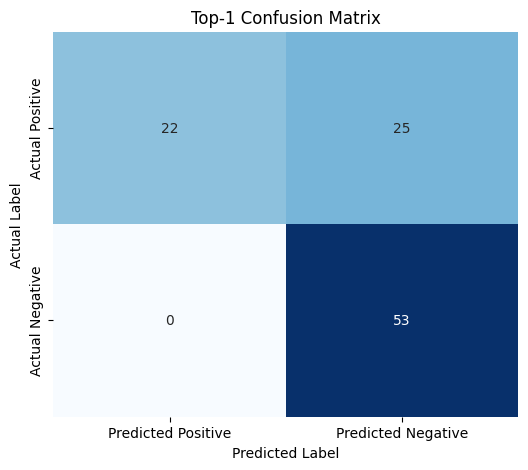

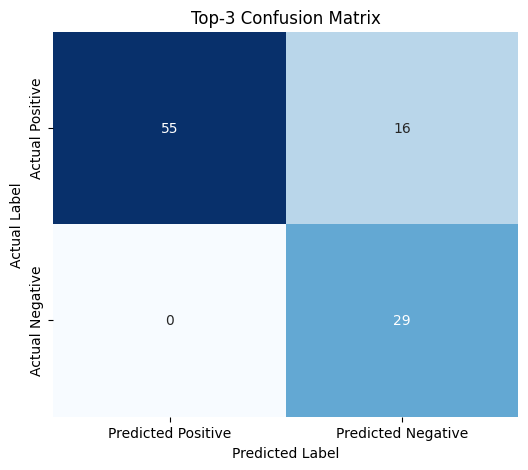

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# True labels and predictions for Top-1 and Top-3
y_true_top1 = np.where(df_results["상위 1개 선호 태그 일치 여부"] | df_results["상위 1개 비선호 태그 일치 여부"], 1, 0)
y_pred_top1 = np.where(df_results["상위 1개 선호 태그 일치 여부"], 1, 0)

y_true_top3 = np.where(df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"] | df_results["예측 상위 3개 비선호에 실제 상위 1개 포함 여부"], 1, 0)
y_pred_top3 = np.where(df_results["예측 상위 3개 선호에 실제 상위 1개 포함 여부"], 1, 0)

# Calculate confusion matrices
conf_matrix_top1 = confusion_matrix(y_true_top1, y_pred_top1)
conf_matrix_top3 = confusion_matrix(y_true_top3, y_pred_top3)

# Reorder confusion matrices to have TP in the top-left corner
conf_matrix_top1 = conf_matrix_top1[[1, 0]][:, [1, 0]]
conf_matrix_top3 = conf_matrix_top3[[1, 0]][:, [1, 0]]

# Define function to plot confusion matrix
def plot_confusion_matrix(cm, title):
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False,
                xticklabels=["Predicted Positive", "Predicted Negative"],
                yticklabels=["Actual Positive", "Actual Negative"])
    plt.xlabel("Predicted Label")
    plt.ylabel("Actual Label")
    plt.title(title)
    plt.show()

# Plot Top-1 and Top-3 confusion matrices
plot_confusion_matrix(conf_matrix_top1, title="Top-1 Confusion Matrix")
plot_confusion_matrix(conf_matrix_top3, title="Top-3 Confusion Matrix")


> **올바른 정답을 예측한 정도**
>___
> top1 accuracy - 75%
>
> top3 accuracy - 84%



*   

*  


*   항목 추가

*   항목 추가

*   항목 추가

*   항목 추가

*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가

*   항목 추가

*   항목 추가

*   항목 추가

*   항목 추가
*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가


*   항목 추가

